<a href="https://colab.research.google.com/github/AIWintermuteAI/Bertelsmann-Tech-Scholarship-Challenge-Course---AI-Track-Nanodegree-Program/blob/master/(Hallucinogenic)_Neural_Transfer_Style_for_Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# (Hallucinogenic) Neural Transfer Style for Video

As part of my series of supplementary notebooks for Bertelsmann-Tech-Scholarship-Challenge-Course---AI-Track-Nanodegree-Program I am publishing this fun notebook. What it does is takes a "content" video and then applies the "style" and some features of the "style" image, frame by frame. The result depends a lot on the parameters you choose, as with the original notebook.

In [0]:
# import resources
%matplotlib inline
import cv2
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
import requests
from torchvision import transforms, models

In [40]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

# move the model to GPU, if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

I had to make some changes in helper functions to make this works with OpenCV video pipeline. Namely, im_convert function - add the reverse normalization and converting the image to INT8 for saving as video frames. Also, the load image function, to accept OpenCV BGR image and convert it to PIL image.

In [0]:
def load_image(img_path, max_size=400, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= 400 pixels in the x-y dims.'''
    if "jpg" in img_path:
        image = Image.open(img_path).convert('RGB')
    else:
        image = cv2.cvtColor(img_path, cv2.COLOR_BGR2RGB)
        image = Image.fromarray(image)
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    normalized_array = (image - np.min(image))/(np.max(image) - np.min(image))
    image = (normalized_array * 255).astype(np.uint8)
    return image

def get_features(image, model, layers=None):
    """ Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
    """
    
    ## TODO: Complete mapping layer names of PyTorch's VGGNet to names from the paper
    ## Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1',
                  '10': 'conv3_1',
                  '19': 'conv4_1',
                  '21': 'conv4_2',
                  '28': 'conv5_1',
        }
        
        
    ## -- do not need to change the code below this line -- ##
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    ## get the batch_size, depth, height, and width of the Tensor
    ## reshape it, so we're multiplying the features for each channel
    ## calculate the gram matrix
    batch_size, d, h, w = tensor.size()
    tensor = tensor.view(d, h*w)
    gram = torch.mm(tensor,tensor.t())
    
    return gram 

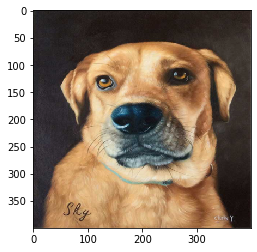

In [44]:
# load in style image,resize style to match content, makes code easier
style = load_image('dog.jpg', shape=(400,400)).to(device)
# display the images
plt.imshow(im_convert(style))
# get  style features only once before forming the target image
style_features = get_features(style, vgg)

# calculate the gram matrices for each layer of our style representation
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}


In [0]:
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 0.1,
                 'conv2_1': 0.3,
                 'conv3_1': 0.5,
                 'conv4_1': 0.8,
                 'conv5_1': 1.0}

# you may choose to leave these as is
content_weight = 1  # alpha
style_weight = 1e12  # beta

Next cell is where all the magic happens. We open the video stream and read images frame by frame. The number of steps and learning rate are tweaked on purpose, to make the process faster. It will still take considerable time though, so have patience.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  after removing the cwd from sys.path.


Total loss:  10197442494464.0


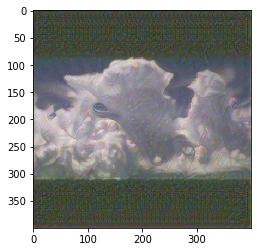

Total loss:  10154895474688.0


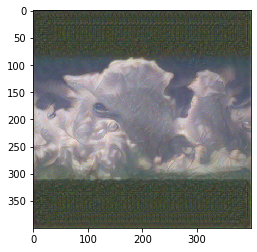

Total loss:  10087988985856.0


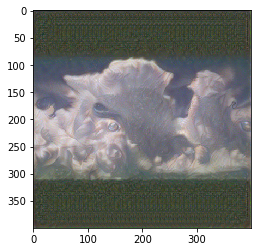

Total loss:  10053972131840.0


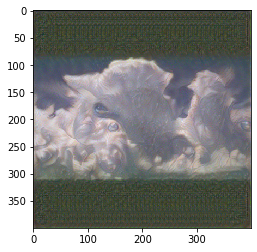

Total loss:  10080223232000.0


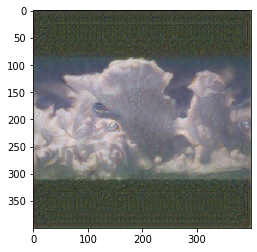

Total loss:  10019368075264.0


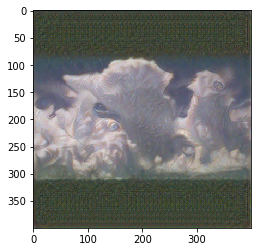

Total loss:  9955425910784.0


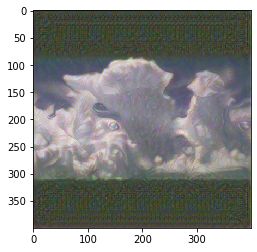

Total loss:  10002446155776.0


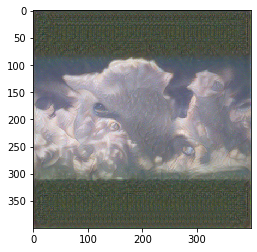

Total loss:  10060969279488.0


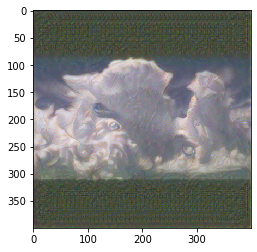

Total loss:  9950137942016.0


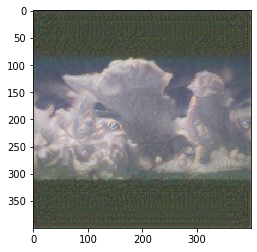

Total loss:  10002033016832.0


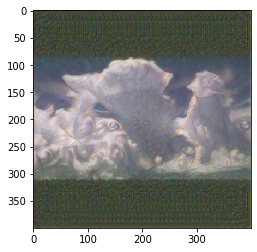

Total loss:  10001244487680.0


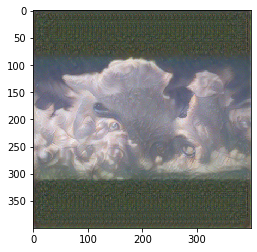

Total loss:  10077083795456.0


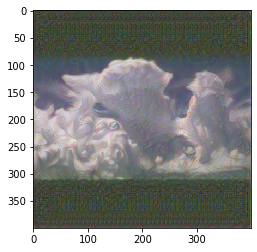

Total loss:  9962930569216.0


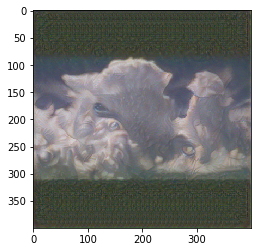

Total loss:  9928073805824.0


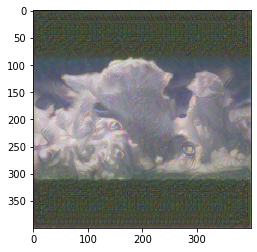

Total loss:  9994747510784.0


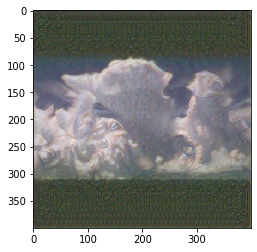

Total loss:  9871599599616.0


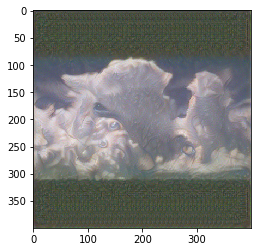

Total loss:  9926962315264.0


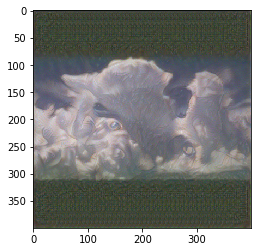

Total loss:  9933180370944.0


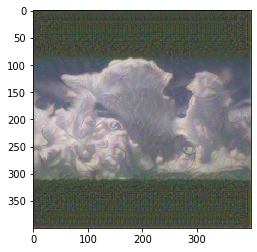

Total loss:  9991087980544.0


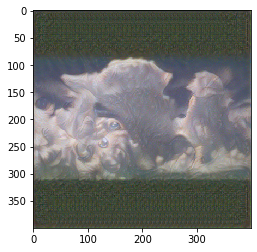

Total loss:  9945335463936.0


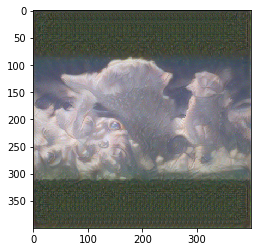

Total loss:  9841748738048.0


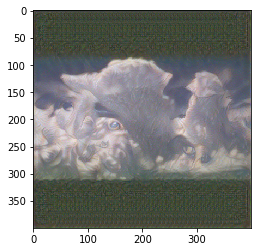

Total loss:  9923591143424.0


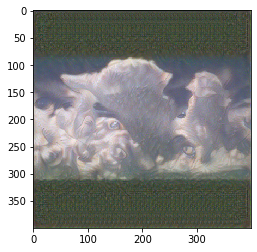

Total loss:  9928323366912.0


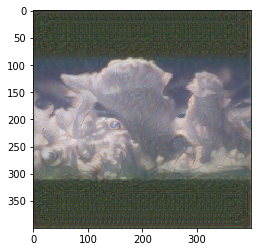

Total loss:  9906797150208.0


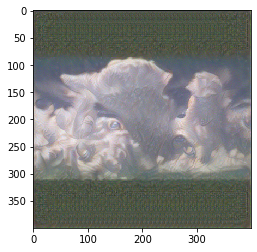

Total loss:  9874148687872.0


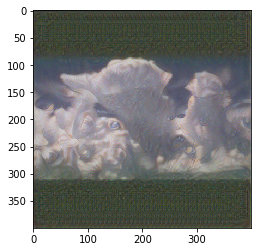

Total loss:  9916271034368.0


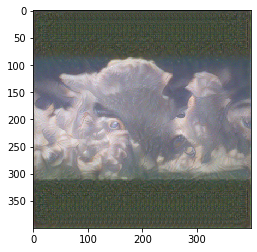

Total loss:  9895615135744.0


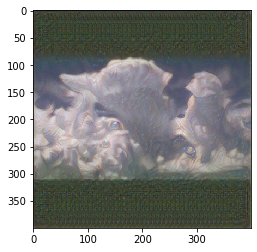

Total loss:  10759578845184.0


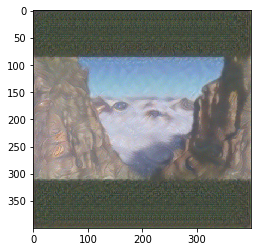

Total loss:  10601273229312.0


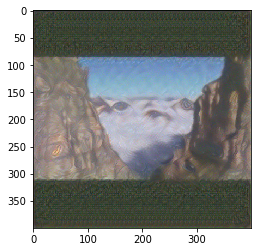

Total loss:  10679328178176.0


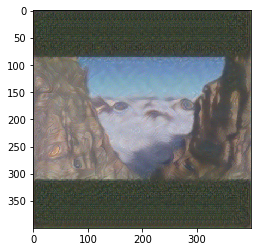

Total loss:  10551329554432.0


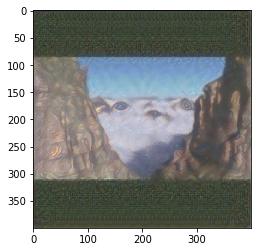

Total loss:  10662040305664.0


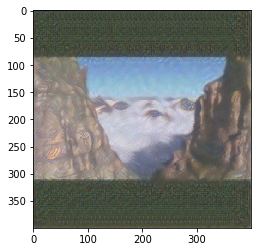

Total loss:  10662431424512.0


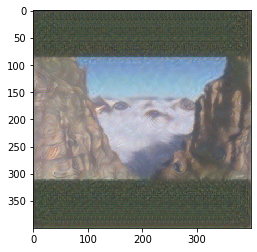

Total loss:  10564349722624.0


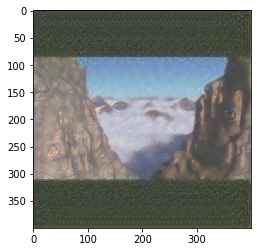

Total loss:  10572931268608.0


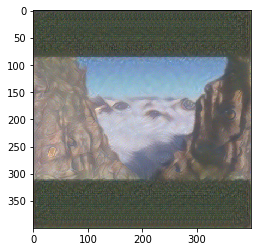

Total loss:  10684992585728.0


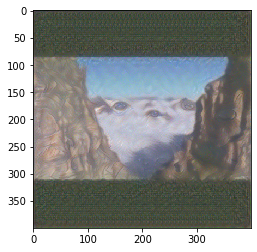

Total loss:  10741156413440.0


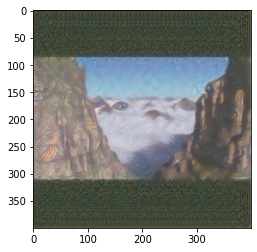

Total loss:  10684222930944.0


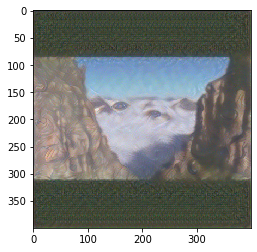

Total loss:  10640775184384.0


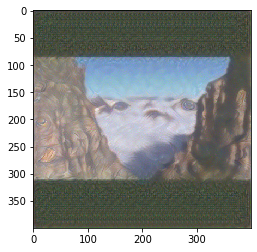

Total loss:  10646449029120.0


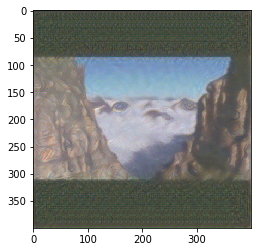

Total loss:  10654229463040.0


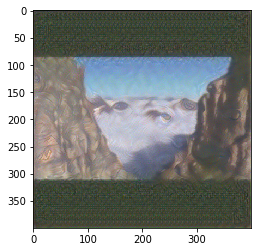

Total loss:  10747993128960.0


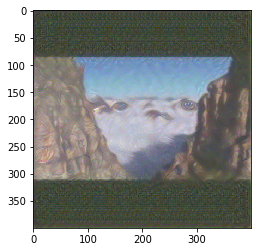

Total loss:  10587557855232.0


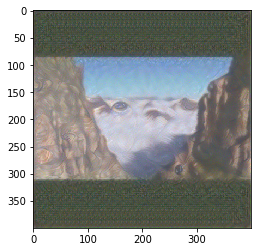

Total loss:  10652036890624.0


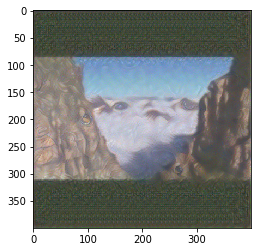

Total loss:  10744483545088.0


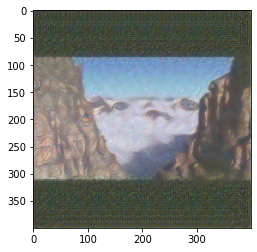

Total loss:  10686092541952.0


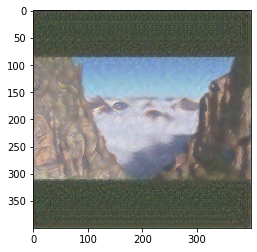

Total loss:  10800045490176.0


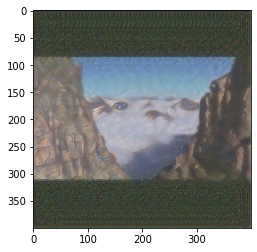

Total loss:  10816674856960.0


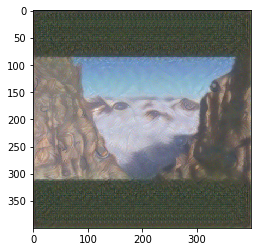

Total loss:  10831639085056.0


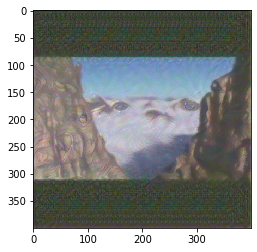

Total loss:  10762732961792.0


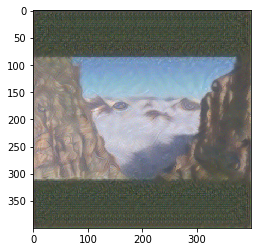

Total loss:  10811233796096.0


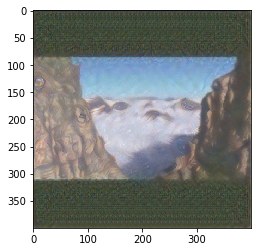

Total loss:  10745194479616.0


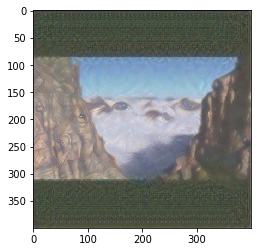

Total loss:  10810152714240.0


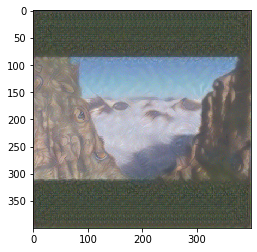

Total loss:  10748501688320.0


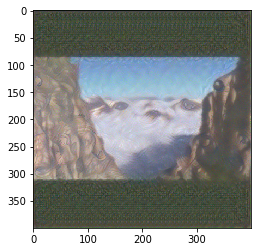

Total loss:  10897980391424.0


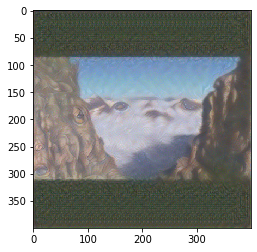

Total loss:  10934713057280.0


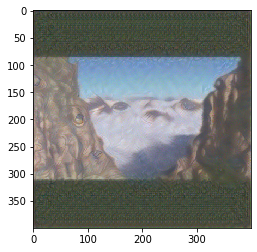

Total loss:  10836291616768.0


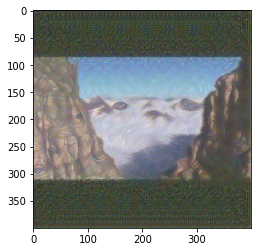

Total loss:  11036129230848.0


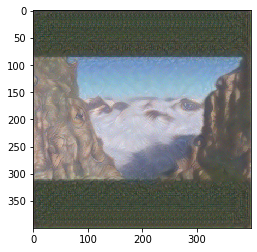

Total loss:  10947902046208.0


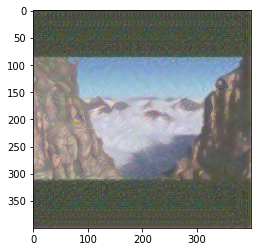

Total loss:  10998367911936.0


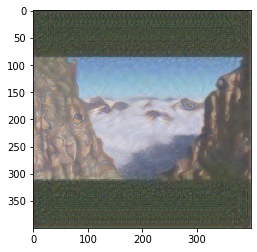

Total loss:  10990580137984.0


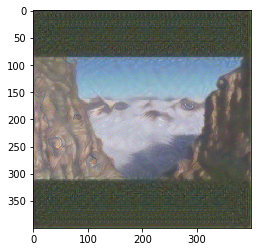

Total loss:  10891162550272.0


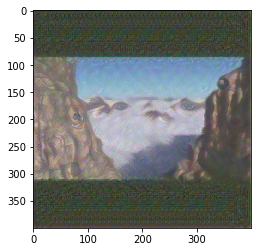

Total loss:  10901746876416.0


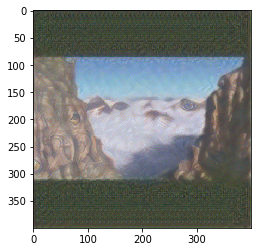

Total loss:  10822059294720.0


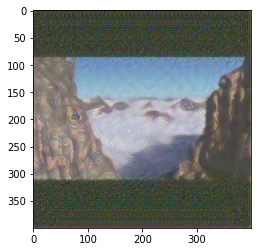

Total loss:  10849205878784.0


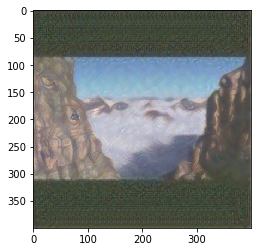

Total loss:  10971022098432.0


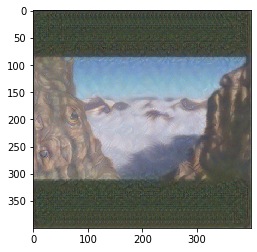

Total loss:  10865289986048.0


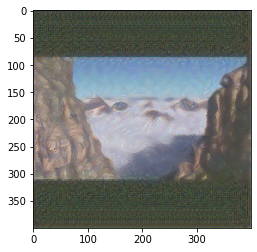

Total loss:  10812030713856.0


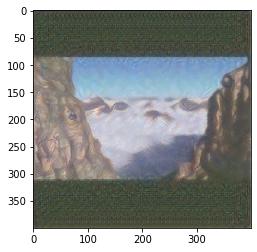

Total loss:  10829664616448.0


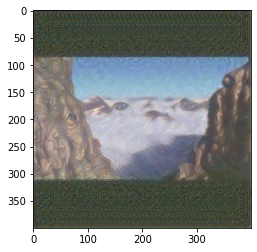

Total loss:  10990873739264.0


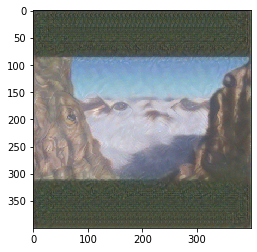

Total loss:  10934509633536.0


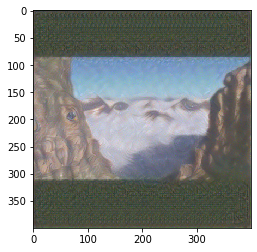

Total loss:  11010084700160.0


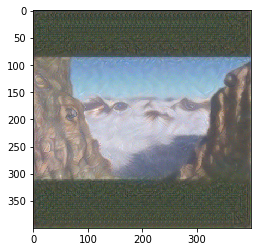

Total loss:  10867313737728.0


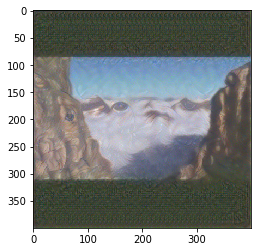

Total loss:  10976237715456.0


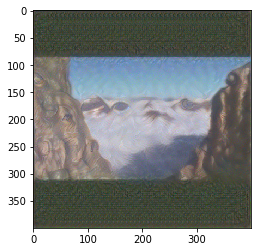

Total loss:  11061427175424.0


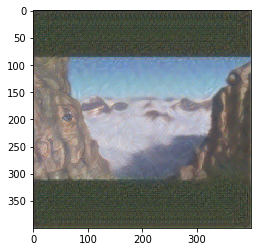

Total loss:  11034928611328.0


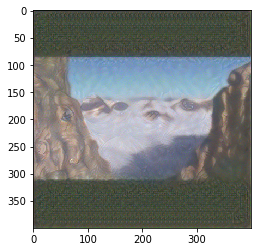

Total loss:  10928170991616.0


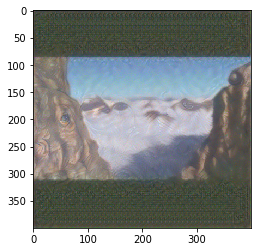

Total loss:  10988577357824.0


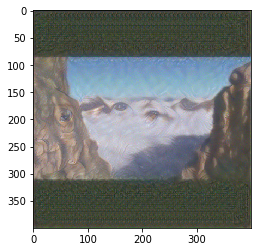

Total loss:  10996085161984.0


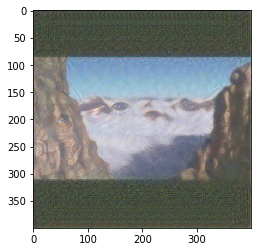

Total loss:  10943320817664.0


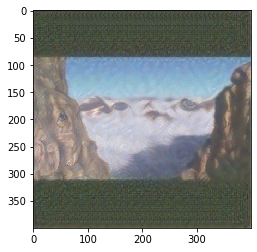

Total loss:  11105434861568.0


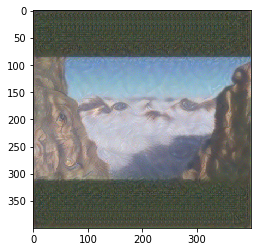

Total loss:  11127841882112.0


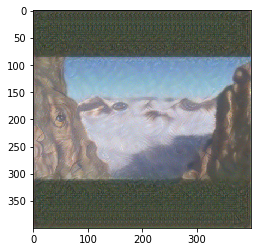

Total loss:  10994509152256.0


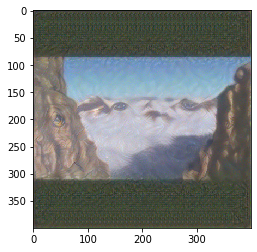

Total loss:  10964388806656.0


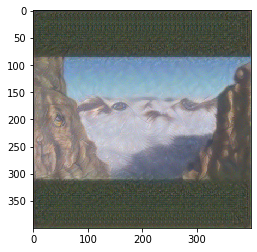

Total loss:  10935043358720.0


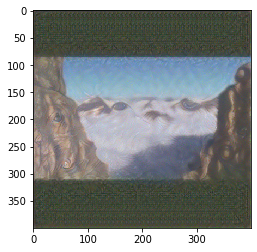

Total loss:  10947610542080.0


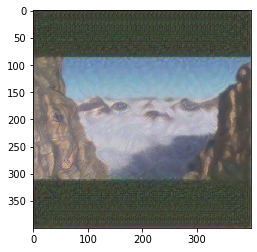

Total loss:  11063971020800.0


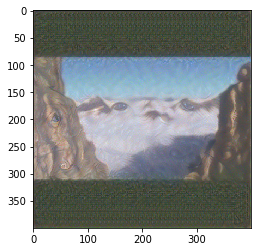

Total loss:  11012834066432.0


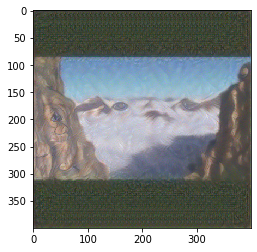

Total loss:  11016935047168.0


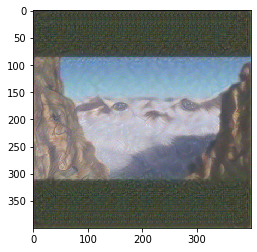

Total loss:  11126358147072.0


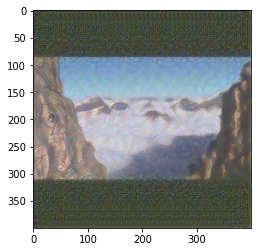

Total loss:  11148319522816.0


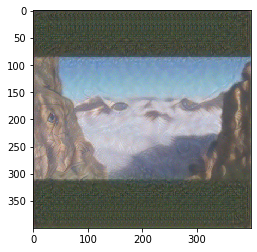

Total loss:  11130848149504.0


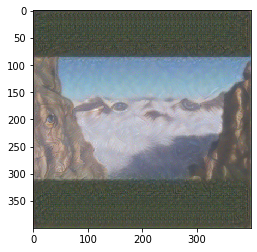

Total loss:  11078045007872.0


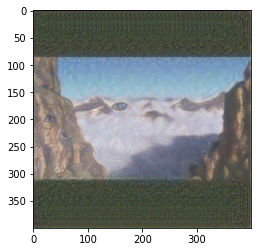

Total loss:  11080033107968.0


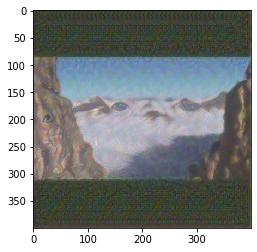

Total loss:  11135034064896.0


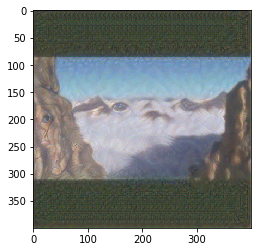

Total loss:  11069342875648.0


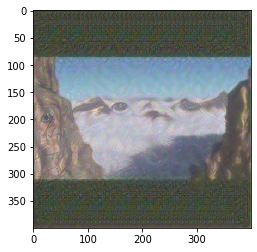

Total loss:  11162148143104.0


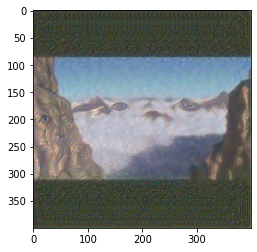

Total loss:  11226144833536.0


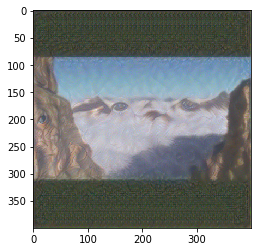

Total loss:  11131966980096.0


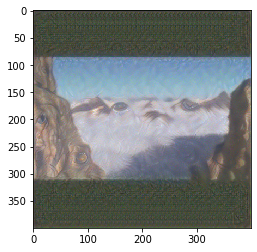

Total loss:  11168912506880.0


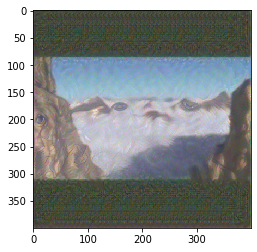

Total loss:  11127983439872.0


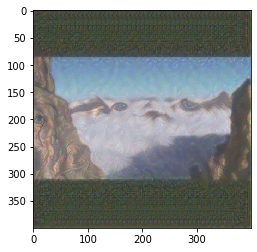

Total loss:  11132926427136.0


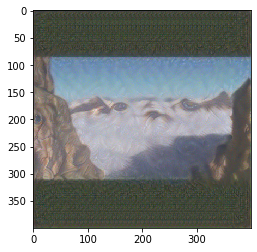

Total loss:  11135246925824.0


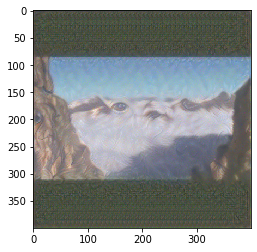

Total loss:  11316805763072.0


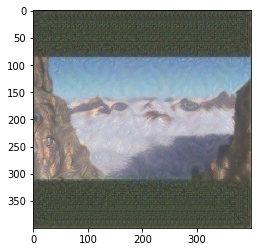

Total loss:  11289926565888.0


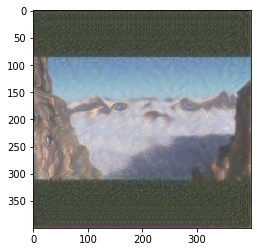

Total loss:  11244002082816.0


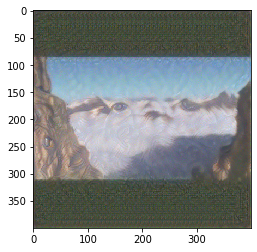

Total loss:  11381933867008.0


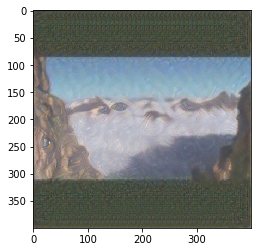

Total loss:  11342753824768.0


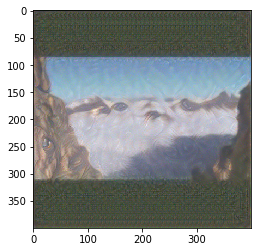

Total loss:  11296259964928.0


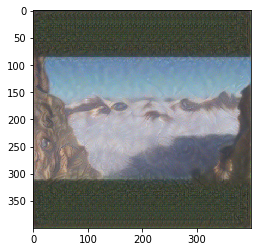

Total loss:  11544496701440.0


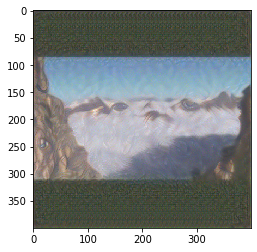

Total loss:  11505527422976.0


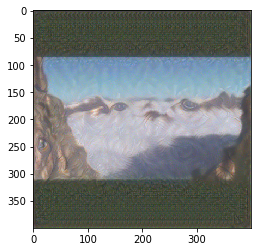

Total loss:  11502273691648.0


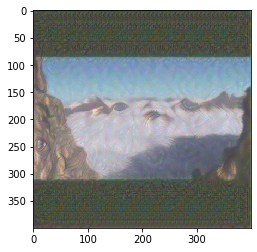

Total loss:  11594163552256.0


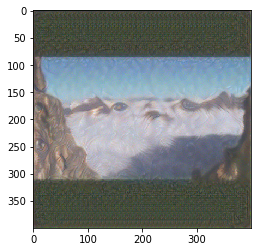

Total loss:  11605785968640.0


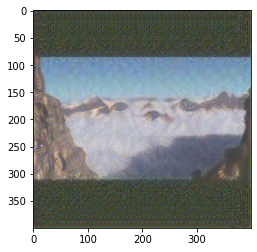

Total loss:  11615650971648.0


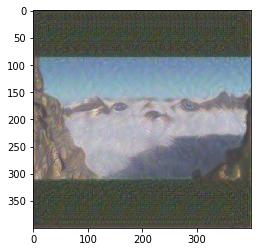

Total loss:  11593688547328.0


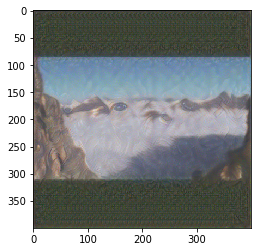

Total loss:  11688436826112.0


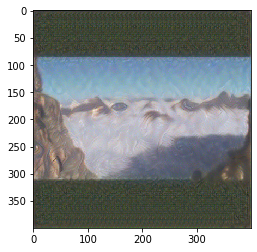

Total loss:  11824582885376.0


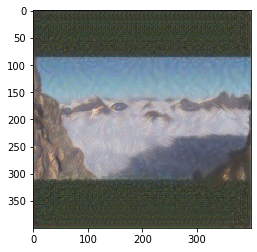

Total loss:  11707087847424.0


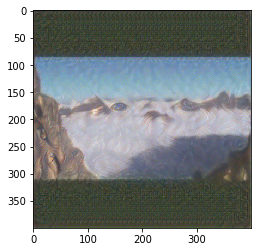

Total loss:  11769387941888.0


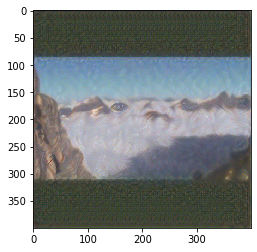

Total loss:  11680162512896.0


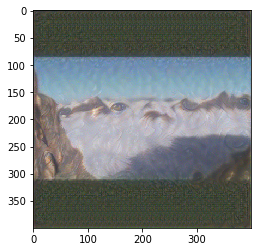

Total loss:  11780329832448.0


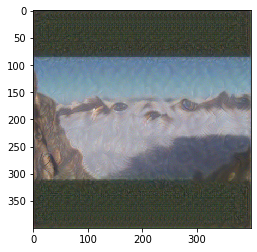

Total loss:  11856763682816.0


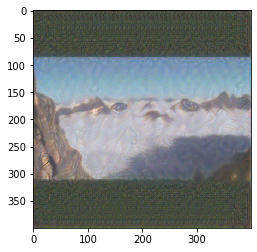

Total loss:  11951158591488.0


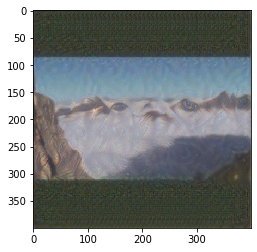

Total loss:  11838128390144.0


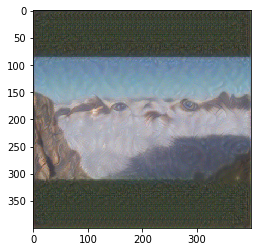

Total loss:  11858285166592.0


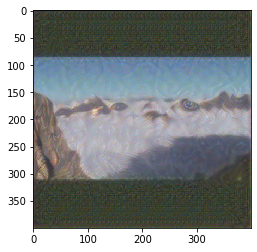

Total loss:  11860033142784.0


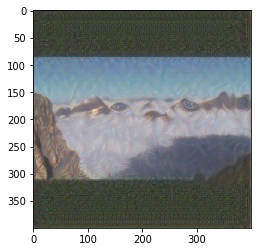

In [49]:
# for displaying the target image, intermittently
show_every = 50

# iteration hyperparameters
steps = 50  # decide how many iterations to update your image (5000)

cap = cv2.VideoCapture('short.mp4')
out = cv2.VideoWriter('output.avi',cv2.VideoWriter_fourcc('M','J','P','G'), 25, (400,400))

while (cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()
    if not ret:
      cap.release()
      out.release()
      break
    content = load_image(frame).to(device)
    target = content.clone().requires_grad_(True).to(device)
    optimizer = optim.Adam([target], lr=0.1)
    # get content and style features only once before forming the target image
    content_features = get_features(content, vgg)
    
    for ii in range(1, steps+1):
    
      ## TODO: get the features from your target image    
      ## Then calculate the content loss
      target_features = get_features(target, vgg)
      content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
      
      # the style loss
      # initialize the style loss to 0
      style_loss = 0

      # iterate through each style layer and add to the style loss
      for layer in style_weights:
      #    # get the "target" style representation for the layer
          target_feature = target_features[layer]
          _, d, h, w = target_feature.shape
          
          ## TODO: Calculate the target gram matrix
          target_gram = gram_matrix(target_feature)
          
          ## TODO:  get the "style" style representation
          style_gram = style_grams[layer]
          ## TODO: Calculate the style loss for one layer, weighted appropriately
          #layer_style_loss = style_weights[layer]*(torch.mean((target_gram - style_gram)**2))
          layer_style_loss = style_weights[layer]*(torch.mean((target_gram - style_gram)**2)+1000*torch.mean((style_features[layer] - content_features[layer])**2))
          # add to the style loss
          style_loss += layer_style_loss / (d * h * w)
          
      ## TODO:  calculate the *total* loss
      total_loss = style_weight*style_loss + content_weight*content_loss
      
      ## -- do not need to change code, below -- ##
      # update your target image
      optimizer.zero_grad()
      total_loss.backward()
      optimizer.step()
      
      # display intermediate images and print the loss
      if  ii % show_every == 0:
          print('Total loss: ', total_loss.item())
          plt.imshow(im_convert(target))
          plt.show()
          out.write(im_convert(target))


## Display the Target Image
After the process is finished you can see the last frame of the video here and download the resulting video from the sidebar. Happy tripping :)

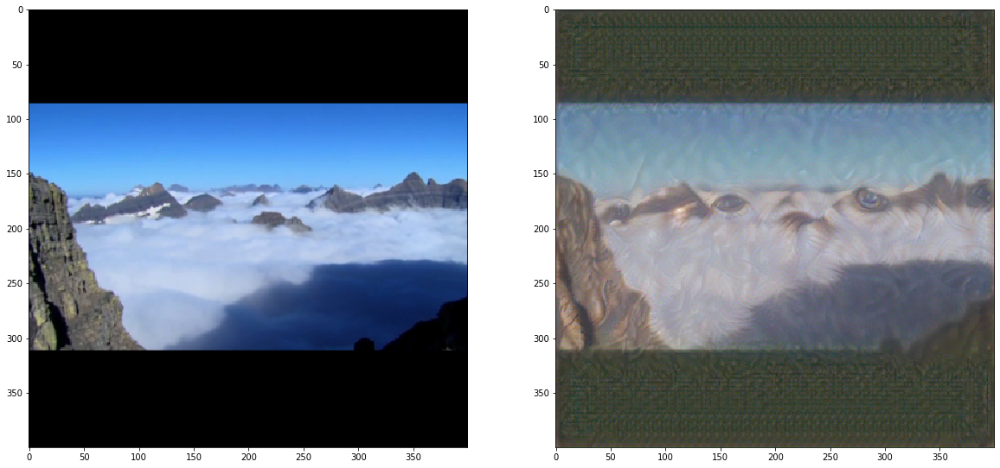

In [50]:
# display content and final, target image
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(target))